In [15]:
import pandas as pd
from pandasgui import show
import plotly.express as px
pd.set_option('display.max_columns', None)


In [16]:
df = pd.read_csv("data/fraudTrain.csv").drop(columns=["Unnamed: 0"])

In [17]:
df.head()

,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,Moravian Falls,NC,28654,36.0788,-81.1781,3495,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0
1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,Orient,WA,99160,48.8878,-118.2105,149,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0
2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,Malad City,ID,83252,42.1808,-112.2620,4154,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0
3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,Boulder,MT,59632,46.2306,-112.1138,1939,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0
4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,Doe Hill,VA,24433,38.4207,-79.4629,99,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0


In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1296675 entries, 0 to 1296674
Data columns (total 22 columns):
 #   Column                 Non-Null Count    Dtype  
---  ------                 --------------    -----  
 0   trans_date_trans_time  1296675 non-null  object 
 1   cc_num                 1296675 non-null  int64  
 2   merchant               1296675 non-null  object 
 3   category               1296675 non-null  object 
 4   amt                    1296675 non-null  float64
 5   first                  1296675 non-null  object 
 6   last                   1296675 non-null  object 
 7   gender                 1296675 non-null  object 
 8   street                 1296675 non-null  object 
 9   city                   1296675 non-null  object 
 10  state                  1296675 non-null  object 
 11  zip                    1296675 non-null  int64  
 12  lat                    1296675 non-null  float64
 13  long                   1296675 non-null  float64
 14  city_pop          

In [19]:
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'])
df['date'] = df['trans_date_trans_time'].dt.date
df['date']

0          2019-01-01
1          2019-01-01
2          2019-01-01
3          2019-01-01
4          2019-01-01
              ...    
1296670    2020-06-21
1296671    2020-06-21
1296672    2020-06-21
1296673    2020-06-21
1296674    2020-06-21
Name: date, Length: 1296675, dtype: object

In [ ]:
from ydata_profiling import ProfileReport
# profile = ProfileReport(df, title="Report")
# profile.to_file("report.html")

In [20]:
fig = px.histogram(df[df['is_fraud'] == 1], x='date', histfunc='count')
fig.show()

In [21]:
fig = px.histogram(df, x='date', y='is_fraud', histfunc='count')
fig.show()


In [22]:
fraud_by_state = df[df['is_fraud']==1]['state'].value_counts().reset_index()
fraud_by_state.columns = ['state', 'count']

fig = px.choropleth(fraud_by_state, 
                    locations='state', 
                    locationmode="USA-states", 
                    color='count',
                    scope="usa",
                    title='Frauds by state',
                    hover_name='state', 
                    color_continuous_scale=px.colors.sequential.Redor)

fig.show()


In [23]:
df['category'].value_counts()

category
gas_transport     131659
grocery_pos       123638
home              123115
shopping_pos      116672
kids_pets         113035
shopping_net       97543
entertainment      94014
food_dining        91461
personal_care      90758
health_fitness     85879
misc_pos           79655
misc_net           63287
grocery_net        45452
travel             40507
Name: count, dtype: int64

In [83]:
fraud_by_category = df['category'].value_counts().reset_index()
fraud_by_category.columns = ['category', 'count']

fig = px.bar(fraud_by_category, x='category', y='count', title='Transactions by Category')
fig.show()


In [24]:
fraud_by_category = df[df['is_fraud']==1]['category'].value_counts().reset_index()
fraud_by_category.columns = ['category', 'count']

fig = px.bar(fraud_by_category, x='category', y='count', title='Frauds by Category')
fig.show()


In [87]:
frauds_by_category = df[df['is_fraud'] == 1]['category'].value_counts().reset_index()
frauds_by_category.columns = ['category', 'fraud_count']

total_by_category = df['category'].value_counts().reset_index()
total_by_category.columns = ['category', 'total_count']

merged = pd.merge(total_by_category, frauds_by_category, on='category')
merged['fraud_percentage'] = (merged['fraud_count'] / merged['total_count']) * 100

merged = merged.sort_values(by='fraud_percentage', ascending=False)
fig = px.bar(merged, x='category', y='fraud_percentage', title='Category Fraud Percentage')
fig.show()


In [72]:
fraud_by_gender = df[df['is_fraud']==1]['gender'].value_counts().reset_index()
fraud_by_gender.columns = ['gender', 'count']

fig = px.pie(fraud_by_gender, values='count', names='gender', title='Frauds by Gender')
fig.show()

In [73]:
df_frauds = df[df['is_fraud']==1]
fraud_by_city_state = df_frauds.groupby(['city', 'state']).size().reset_index(name='count')
fraud_by_city_state = fraud_by_city_state.sort_values(by='count', ascending=False).head(10)

fraud_by_city_state['city_state'] = fraud_by_city_state['city'] + ', ' + fraud_by_city_state['state']

fig = px.bar(fraud_by_city_state, x='city_state', y='count', title='Top 10 Cities with Most Frauds')
fig.show()

In [75]:
df_frauds = df[df['is_fraud']==1]
fraud_by_merchant = df_frauds['merchant'].value_counts().reset_index()
fraud_by_merchant.columns = ['merchant', 'count']
fraud_by_merchant = fraud_by_merchant.sort_values(by='count', ascending=False).head(10)

fig = px.bar(fraud_by_merchant, x='merchant', y='count', title='Top 10 Merchants with Most Frauds')
fig.show()

In [77]:
total_by_merchant = df['merchant'].value_counts().reset_index()
total_by_merchant.columns = ['merchant', 'total']

fraud_by_merchant = df_frauds['merchant'].value_counts().reset_index()
fraud_by_merchant.columns = ['merchant', 'fraud']

merged = pd.merge(total_by_merchant, fraud_by_merchant, on='merchant')
merged['fraud_percentage'] = (merged['fraud'] / merged['total']) * 100
merged = merged.sort_values(by='fraud_percentage', ascending=False).head(10)

fig = px.bar(merged, x='merchant', y='fraud_percentage', title='Top 10 Merchants with Highest Fraud Percentage')
fig.show()

In [104]:
total_by_job = df['job'].value_counts().reset_index()
total_by_job.columns = ['job', 'total']

fraud_by_job = df[df['is_fraud']==1]['job'].value_counts().reset_index()
fraud_by_job.columns = ['job', 'fraud']

merged = pd.merge(total_by_job, fraud_by_job, on='job')
merged['fraud_percentage'] = (merged['fraud'] / merged['total']) * 100
merged = merged.sort_values(by='fraud_percentage', ascending=False).head(10)

merged['fraud_to_total'] = 'Fraud/Total: ' + merged['fraud'].astype(str) + '/' + merged['total'].astype(str)

fig = px.bar(merged, x='job', y='fraud_percentage', 
             text='fraud_to_total', 
             title='Top 10 Jobs with Highest Fraud Percentage')
fig.update_traces(textposition='outside')
fig.show()

In [78]:
from math import radians, sin, cos, sqrt, atan2

def calculate_distance(row):
    # Radius of the earth in kilometers
    R = 6371.0

    lat1 = radians(row['lat'])
    lon1 = radians(row['long'])
    lat2 = radians(row['merch_lat'])
    lon2 = radians(row['merch_long'])

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))

    distance = R * c
    return distance

df['distance'] = df.apply(calculate_distance, axis=1)


In [80]:
average_distance = df['distance'].mean()
print("Average distance for the whole dataframe:", average_distance, "km")

average_distance_frauds = df[df['is_fraud'] == 1]['distance'].mean()
print("Average distance for the frauds:", average_distance_frauds, "km")

Average distance for the whole dataframe: 76.11465060395156 km
Average distance for the frauds: 76.268329626882 km


In [82]:
average_city_pop = df['city_pop'].mean()
print("Average city_pop for the whole dataframe:", average_city_pop)

average_city_pop_frauds = df[df['is_fraud'] == 1]['city_pop'].mean()
print("Average city_pop for the frauds:", average_city_pop_frauds)

Average city_pop for the whole dataframe: 88824.44056297839
Average city_pop for the frauds: 97276.76325606182


maybe this cloud mean that the frauds are in bigger cities?

In [ ]:
# Average distance for the whole dataframe
average_distance = df['distance'].mean()
print("Average distance for the whole dataframe:", average_distance, "km")

# Average distance for the frauds
average_distance_frauds = df[df['is_fraud'] == 1]['distance'].mean()
print("Average distance for the frauds:", average_distance_frauds, "km")

In [26]:
from sklearn.preprocessing import LabelEncoder

prep_df = pd.read_csv("data/fraudTrain.csv").drop(columns=["Unnamed: 0"])

prep_df['date'] = pd.to_datetime(prep_df['trans_date_trans_time'])
prep_df['month'] = prep_df['date'].dt.month
prep_df['day_of_week'] = prep_df['date'].dt.dayofweek
prep_df['hour'] = prep_df['date'].dt.hour
prep_df = prep_df.drop(columns=['trans_date_trans_time', 'date', 'trans_num'])

prep_df['dob'] = pd.to_datetime(prep_df['dob'])

prep_df['unix_time'] = prep_df['unix_time'] - prep_df['unix_time'].min()

label_encoder = LabelEncoder()
columns_to_encode = ['merchant', 'category', 'first', 'last', 'gender', 'street', 'city', 'state', 'job']
for column in columns_to_encode:
    prep_df[column] = label_encoder.fit_transform(prep_df[column])


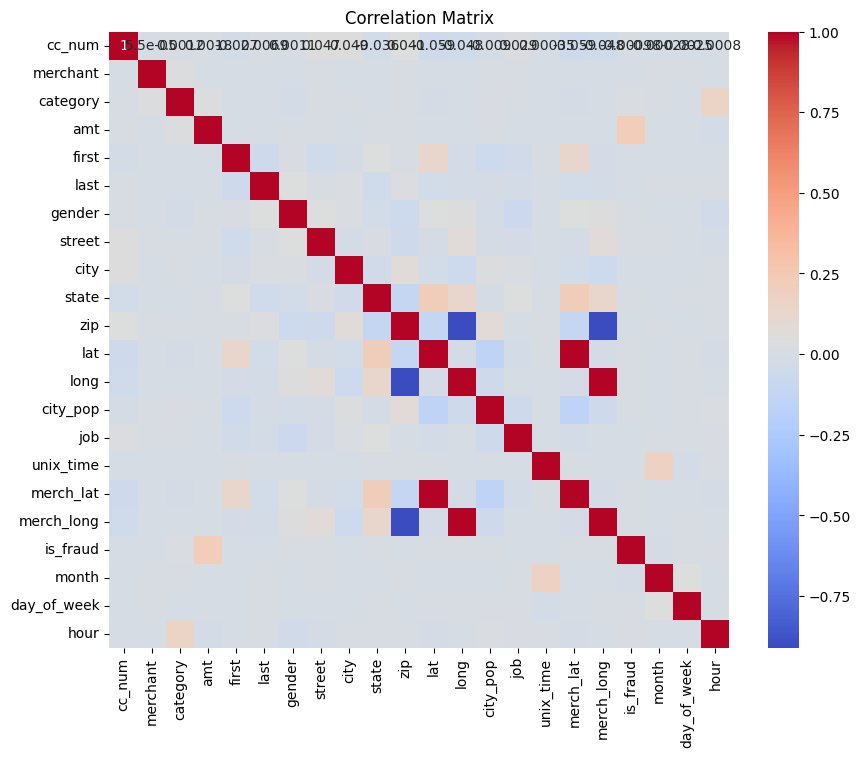

In [58]:
import seaborn as sns
import matplotlib.pyplot as plt

correlation_matrix = prep_df.select_dtypes(include='number').corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True)
plt.title('Correlation Matrix')
plt.show()

### A person cc_num az egy-egy kapcsolat

pár ember van ugyan azzal a névvel de különböző date oif birthel

In [98]:
df['person'] = df['first'] + ' ' + df['last'] + ' ' + df['dob']
df_multiple_cc  = df.groupby('person')['cc_num'].nunique()
df_multiple_cc[df_multiple_cc > 1]

Series([], Name: cc_num, dtype: int64)

In [99]:
df_multiple_cc  =df[['person','cc_num']].drop_duplicates().groupby('person')['cc_num'].count()
df_multiple_cc[df_multiple_cc > 1]

Series([], Name: cc_num, dtype: int64)

In [100]:
df['person'] = df['first'] + ' ' + df['last']
df_multiple_cc  = df.groupby('cc_num')['person'].nunique()
df_multiple_cc[df_multiple_cc > 1]

Series([], Name: person, dtype: int64)

### Mikor válnak fraud-á a tranzakciók?
nem látok konkrét összefüggést

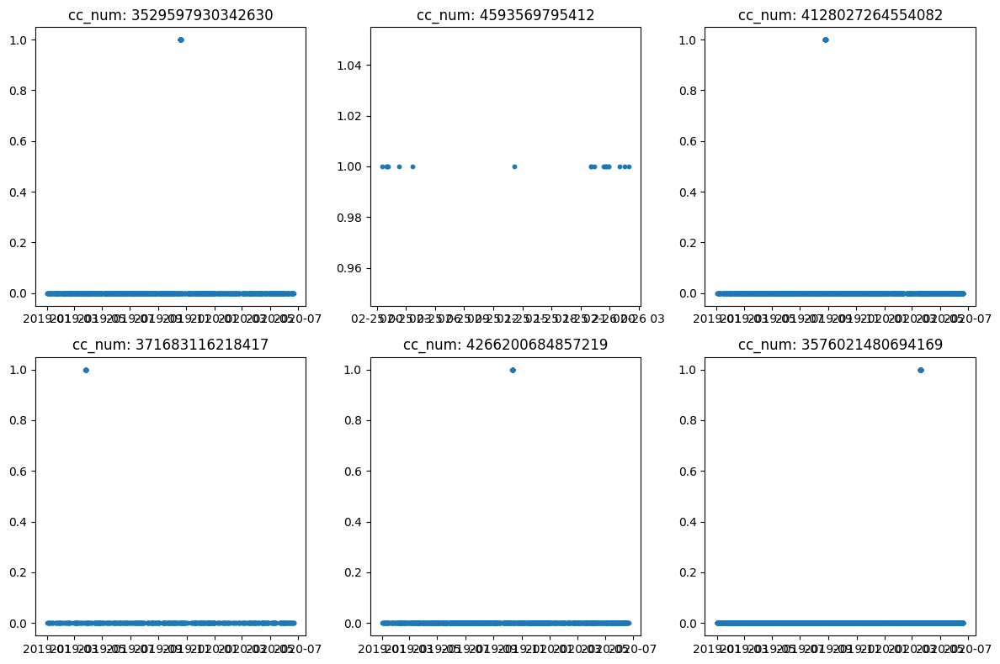

In [71]:
import random
import matplotlib.pyplot as plt

# Get 6 random fraud_cc_num
random_cc_nums = random.sample(df[df['is_fraud'] == 1]['cc_num'].unique().tolist(), 6)

# Create subplots
fig, axes = plt.subplots(2, 3, figsize=(12, 8))

# Iterate over the random_cc_nums and plot on subplots
for i, cc_num in enumerate(random_cc_nums):
    row = i // 3
    col = i % 3
    df2 = df[df['cc_num'] == cc_num].sort_values(by='unix_time')
    axes[row, col].scatter(df2['trans_date_trans_time'], df2['is_fraud'], s=10)
    axes[row, col].set_title(f"cc_num: {cc_num}")

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


In [88]:
df_selected = df[df['cc_num'] == 4128027264554082]

In [93]:
df_selected[df_selected['is_fraud'] == 0]['amt'].mean()

60.06694681549573

In [92]:
df_selected[df_selected['is_fraud'] == 1]['amt'].mean()

588.0963636363637